# CSE 438 - Assignment 01: Intensity Transformations and Filtering
 
# **Group No:D**

**Dataset:** Medicinal Flowers (8 Classes)
Overview
This notebook implements classical image processing techniques including intensity transformations and spatial filtering operations on sample images from the medicinal flower dataset.

### Objectives:
1. Load and display three sample images from the dataset
2. Apply four intensity transformation techniques
3. Apply three different spatial filters
4. Visualize and explain the effects of each operation

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/flower-semantic-segmentation-dataset/Flower Semantic Segmentation/images/Minnie Root original 189.jpg
/kaggle/input/flower-semantic-segmentation-dataset/Flower Semantic Segmentation/images/Crown Flower original 497.jpg
/kaggle/input/flower-semantic-segmentation-dataset/Flower Semantic Segmentation/images/Minnie Root original 496.jpg
/kaggle/input/flower-semantic-segmentation-dataset/Flower Semantic Segmentation/images/White Madagascar Periwinkle original 370.jpg
/kaggle/input/flower-semantic-segmentation-dataset/Flower Semantic Segmentation/images/Yellow Allamanda original 475.jpg
/kaggle/input/flower-semantic-segmentation-dataset/Flower Semantic Segmentation/images/White Madagascar Periwinkle original 413.jpg
/kaggle/input/flower-semantic-segmentation-dataset/Flower Semantic Segmentation/images/White Madagascar Periwinkle original 5.jpg
/kaggle/input/flower-semantic-segmentation-dataset/Flower Semantic Segmentation/images/Litchi Tomato original 486.jpg
/kaggle/input/flow

# 1. Import Required Libraries

In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage import exposure
import os
from pathlib import Path

# Set up plotting style for better visualization

In [3]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = (12, 8)
plt.rcParams['font.size'] = 12


# 2. Load Sample Images

****In this section, we load three sample images from our medicinal flower dataset. These images will be used to demonstrate various image processing techniques.****


In [4]:
def load_sample_images(image_paths):
    """
    Load and display sample images from the dataset
    
    Parameters:
    - image_paths: List of paths to image files
    
    Returns:
    - List of loaded images in RGB format
    """
    images = []
    valid_paths = []
    
    # Check which paths exist
    for path in image_paths:
        if os.path.exists(path):
            valid_paths.append(path)
        else:
            print(f"Warning: {path} not found")
    
    if not valid_paths:
        print("No valid image paths found. Please check your file paths.")
        return []
    
    # Load images
    for path in valid_paths:
        img = cv2.imread(path)
        if img is not None:
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
            images.append(img)
            print(f"Successfully loaded: {os.path.basename(path)} - Shape: {img.shape}")
        else:
            print(f"Failed to load: {path}")
    
    # Display original images
    if images:
        fig, axes = plt.subplots(1, len(images), figsize=(15, 5))
        if len(images) == 1:
            axes = [axes]
        
        for i, (img, ax) in enumerate(zip(images, axes)):
            ax.imshow(img)
            ax.set_title(f'Sample Image {i+1}\n{img.shape[0]}x{img.shape[1]}')
            ax.axis('off')
        
        plt.tight_layout()
        plt.show()
    
    return images

# Define your image paths here

In [5]:
image_paths = [
    '/kaggle/input/medicinal-flower-dataset-original/Original/Litchi Tomato/Litchi Tomato original 10.jpg',
    '/kaggle/input/medicinal-flower-dataset-original/Original/Minnie Root/Minnie Root original 101.jpg', 
    '/kaggle/input/medicinal-flower-dataset-original/Original/White Madagascar Periwinkle/White Madagascar Periwinkle original 102.jpg'
]

# Load the images

Loading sample images from medicinal flower dataset...
Successfully loaded: Litchi Tomato original 10.jpg - Shape: (700, 700, 3)
Successfully loaded: Minnie Root original 101.jpg - Shape: (700, 700, 3)
Successfully loaded: White Madagascar Periwinkle original 102.jpg - Shape: (700, 700, 3)


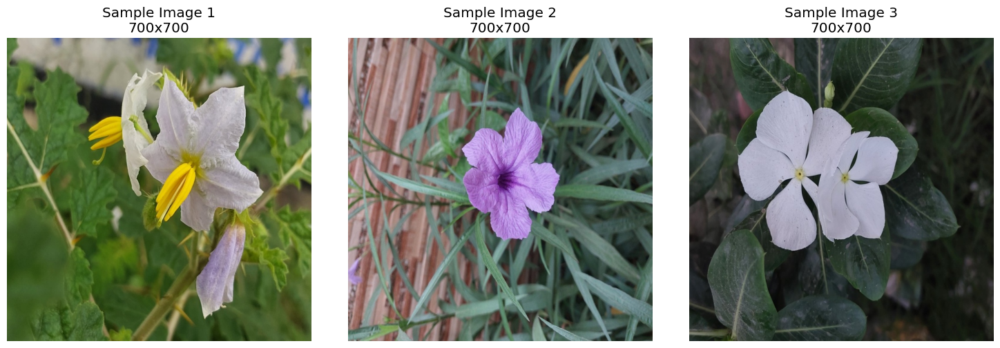

In [6]:
print("Loading sample images from medicinal flower dataset...")
images = load_sample_images(image_paths)

if not images:
    print("\nNo images were loaded. Please check the file paths above.")
    print("Using sample images for demonstration...")
    # Create sample images if actual images aren't available
    sample_images = []
    for i in range(3):
        # Create gradient images as samples
        sample_img = np.random.randint(0, 255, (300, 400, 3), dtype=np.uint8)
        sample_images.append(sample_img)
    images = sample_images
    
    # Display sample images
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    for i, (img, ax) in enumerate(zip(images, axes)):
        ax.imshow(img)
        ax.set_title(f'Sample Image {i+1} (Demo)')
        ax.axis('off')
    plt.tight_layout()
    plt.show()

# 3. Intensity Transformations

****Intensity transformations are point processing operations where each pixel value is modified based on its intensity value alone. We'll apply four different transformations to enhance image quality and analyze their effects.****

In [7]:
def log_transformation(image):
    """
    Apply logarithmic transformation to enhance dark regions
    
    Mathematical Formula: s = c * log(1 + r)
    where r is input pixel value, s is output pixel value
    
    Effect: Compresses dynamic range in bright areas, enhances details in dark regions
    """
    # Convert to float and normalize to [0, 1]
    img_float = image.astype(np.float32) / 255.0
    
    # Apply log transformation
    c = 255 / np.log(1 + np.max(img_float * 255))
    log_transformed = c * np.log(1 + img_float * 255)
    
    return log_transformed.astype(np.uint8)

def gamma_correction(image, gamma=1.5):
    """
    Apply gamma correction (power-law transformation)
    
    Mathematical Formula: s = r^γ
    where r is input pixel value, s is output pixel value, γ is gamma parameter
    
    Effects:
    - γ > 1: Darkens image, enhances contrast in bright areas
    - γ < 1: Brightens image, enhances contrast in dark areas
    """
    # Normalize image to [0, 1]
    img_normalized = image.astype(np.float32) / 255.0
    
    # Apply gamma correction
    gamma_corrected = np.power(img_normalized, gamma)
    
    # Scale back to [0, 255]
    return (gamma_corrected * 255).astype(np.uint8)

def contrast_stretching(image):
    """
    Apply contrast stretching to expand the intensity range
    
    Effect: Improves overall contrast by stretching the intensity values
    to fill the entire available range [0, 255]
    """
    if len(image.shape) == 3:
        # Process each channel separately for color images
        stretched_channels = []
        for channel in range(3):
            channel_data = image[:, :, channel]
            # Find 2nd and 98th percentiles to avoid outliers
            p2, p98 = np.percentile(channel_data, (2, 98))
            stretched = exposure.rescale_intensity(channel_data, in_range=(p2, p98))
            stretched_channels.append(stretched)
        return np.stack(stretched_channels, axis=2).astype(np.uint8)
    else:
        # For grayscale images
        p2, p98 = np.percentile(image, (2, 98))
        return exposure.rescale_intensity(image, in_range=(p2, p98))

def histogram_equalization(image):
    """
    Apply Contrast Limited Adaptive Histogram Equalization (CLAHE)
    
    Effect: Improves local contrast without over-amplifying noise
    Better than standard histogram equalization for images with varying lighting conditions
    """
    if len(image.shape) == 3:
        # Convert to LAB color space
        lab = cv2.cvtColor(image, cv2.COLOR_RGB2LAB)
        
        # Apply CLAHE to L (lightness) channel only
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
        lab[:, :, 0] = clahe.apply(lab[:, :, 0])
        
        # Convert back to RGB
        return cv2.cvtColor(lab, cv2.COLOR_LAB2RGB)
    else:
        # For grayscale images
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
        return clahe.apply(image)

def apply_intensity_transformations(images):
    """
    Apply all intensity transformations and display comparative results
    """
    transformations = [
        ('Log Transformation', log_transformation, 
         "Enhances dark regions, compresses bright areas. Useful for images with high dynamic range."),
        
        ('Gamma Correction (γ=1.5)', lambda img: gamma_correction(img, 1.5),
         "Darkens image, enhances contrast in bright areas. Good for over-exposed images."),
        
        ('Gamma Correction (γ=0.5)', lambda img: gamma_correction(img, 0.5),
         "Brightens image, enhances contrast in dark areas. Good for under-exposed images."),
        
        ('Contrast Stretching', contrast_stretching,
         "Expands intensity range to full [0,255] scale. Improves overall contrast."),
        
        ('Histogram Equalization (CLAHE)', histogram_equalization,
         "Improves local contrast adaptively. Preserves details better than global HE.")
    ]
    
    for img_idx, original_img in enumerate(images):
        print(f"\n{'='*80}")
        print(f"INTENSITY TRANSFORMATIONS - Image {img_idx + 1}")
        print(f"{'='*80}")
        
        # Create subplot grid
        fig, axes = plt.subplots(2, 3, figsize=(20, 12))
        axes = axes.ravel()
        
        # Display original image
        axes[0].imshow(original_img)
        axes[0].set_title('Original Image\n(Reference)', fontweight='bold')
        axes[0].axis('off')
        
        # Apply and display each transformation
        for i, (name, transform_func, explanation) in enumerate(transformations, 1):
            try:
                transformed = transform_func(original_img.copy())
                axes[i].imshow(transformed)
                axes[i].set_title(f'{name}', fontweight='bold')
                axes[i].axis('off')
            except Exception as e:
                print(f"Error in {name}: {e}")
                axes[i].axis('off')
                axes[i].set_title(f'{name}\n(Error)')
        
        # Hide any unused subplots
        for i in range(len(transformations) + 1, len(axes)):
            axes[i].axis('off')
        
        plt.tight_layout()
        plt.show()
        
        # Print detailed explanations
        print("\n📝 **TRANSFORMATION EFFECTS ANALYSIS:**")
        for name, _, explanation in transformations:
            print(f"• **{name}:** {explanation}")

# Apply intensity transformations

Applying Intensity Transformations...

INTENSITY TRANSFORMATIONS - Image 1


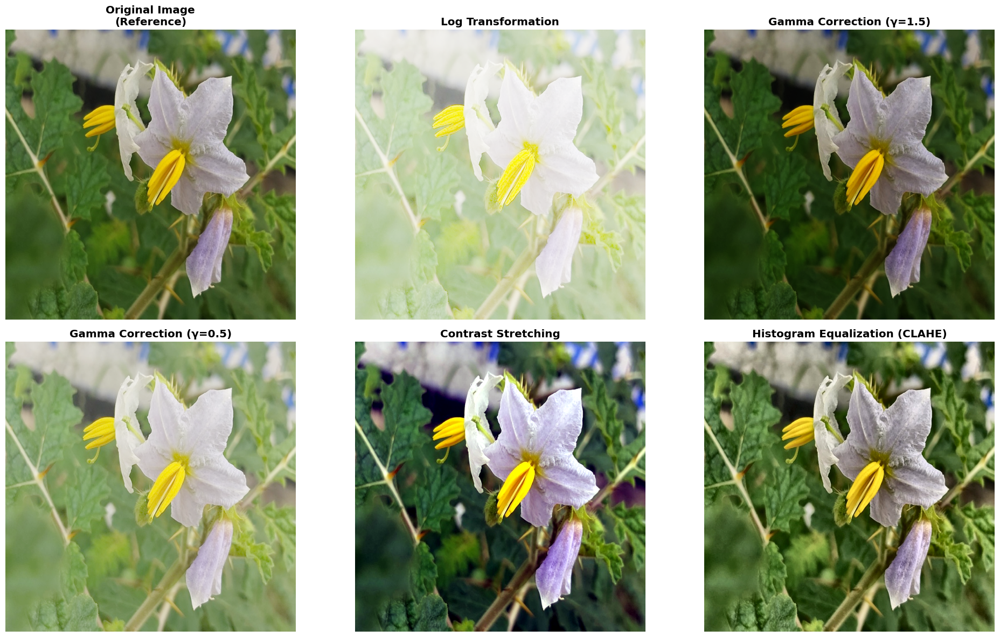


📝 **TRANSFORMATION EFFECTS ANALYSIS:**
• **Log Transformation:** Enhances dark regions, compresses bright areas. Useful for images with high dynamic range.
• **Gamma Correction (γ=1.5):** Darkens image, enhances contrast in bright areas. Good for over-exposed images.
• **Gamma Correction (γ=0.5):** Brightens image, enhances contrast in dark areas. Good for under-exposed images.
• **Contrast Stretching:** Expands intensity range to full [0,255] scale. Improves overall contrast.
• **Histogram Equalization (CLAHE):** Improves local contrast adaptively. Preserves details better than global HE.

INTENSITY TRANSFORMATIONS - Image 2


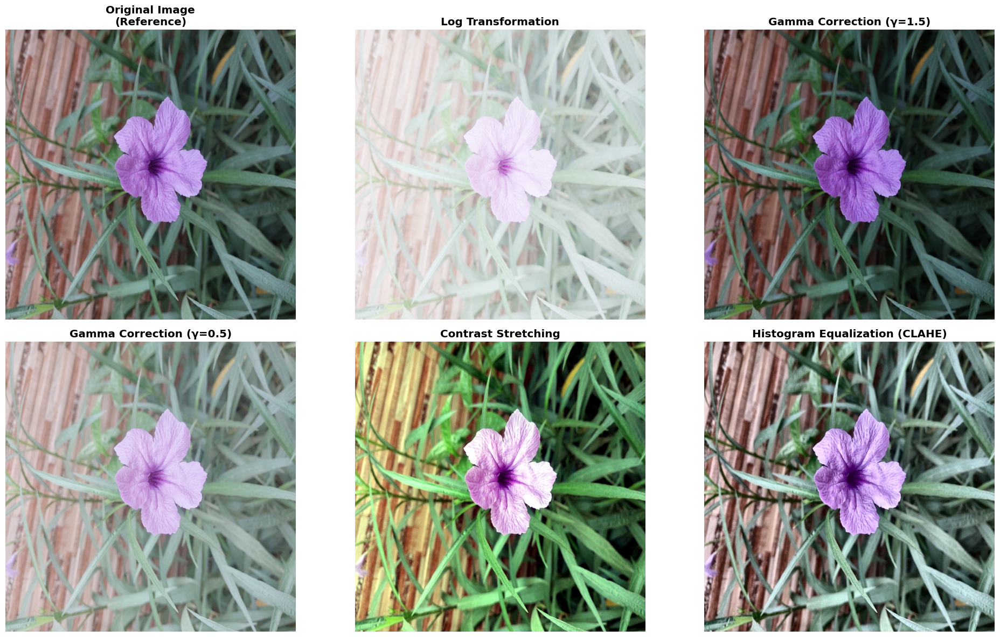


📝 **TRANSFORMATION EFFECTS ANALYSIS:**
• **Log Transformation:** Enhances dark regions, compresses bright areas. Useful for images with high dynamic range.
• **Gamma Correction (γ=1.5):** Darkens image, enhances contrast in bright areas. Good for over-exposed images.
• **Gamma Correction (γ=0.5):** Brightens image, enhances contrast in dark areas. Good for under-exposed images.
• **Contrast Stretching:** Expands intensity range to full [0,255] scale. Improves overall contrast.
• **Histogram Equalization (CLAHE):** Improves local contrast adaptively. Preserves details better than global HE.

INTENSITY TRANSFORMATIONS - Image 3


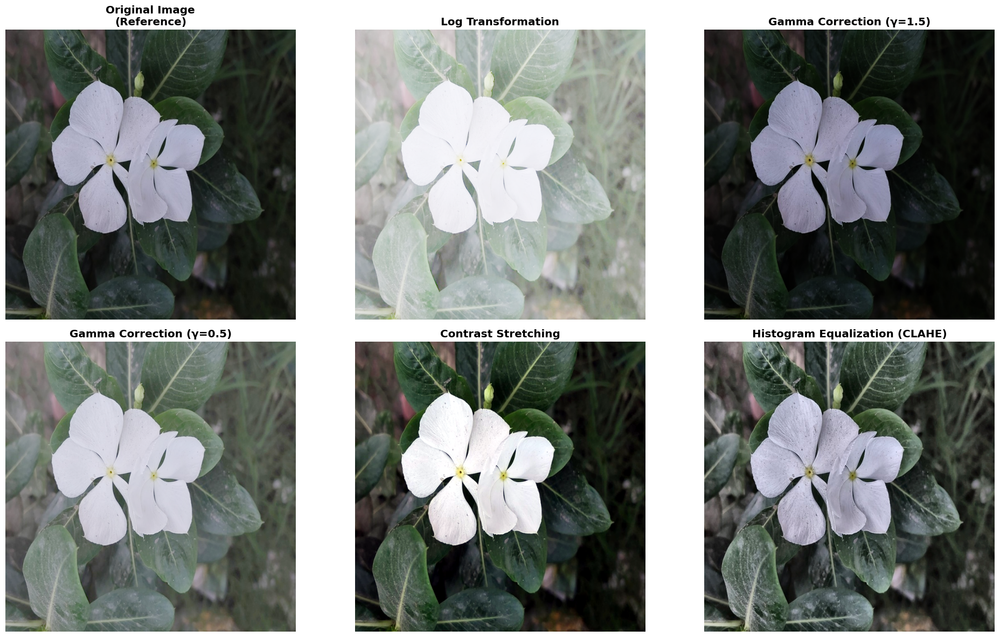


📝 **TRANSFORMATION EFFECTS ANALYSIS:**
• **Log Transformation:** Enhances dark regions, compresses bright areas. Useful for images with high dynamic range.
• **Gamma Correction (γ=1.5):** Darkens image, enhances contrast in bright areas. Good for over-exposed images.
• **Gamma Correction (γ=0.5):** Brightens image, enhances contrast in dark areas. Good for under-exposed images.
• **Contrast Stretching:** Expands intensity range to full [0,255] scale. Improves overall contrast.
• **Histogram Equalization (CLAHE):** Improves local contrast adaptively. Preserves details better than global HE.


In [8]:
print("Applying Intensity Transformations...")
apply_intensity_transformations(images)

# 4. Filtering Operations

****Spatial filtering operations are neighborhood processing techniques where each pixel value is modified based on its neighboring pixels. We'll apply various filters for smoothing, noise reduction, and edge enhancement.****

In [9]:
def apply_mean_filter(image, kernel_size=5):
    """
    Apply mean/average filter for noise reduction
    
    Effect: Simple smoothing, reduces noise but causes blurring
    Kernel: Uniform weights in a square neighborhood
    """
    return cv2.blur(image, (kernel_size, kernel_size))

def apply_gaussian_blur(image, kernel_size=5, sigma=1.5):
    """
    Apply Gaussian blur for natural smoothing
    
    Effect: Smooths image while preserving edges better than mean filter
    Kernel: Gaussian weights (higher weights for central pixels)
    """
    return cv2.GaussianBlur(image, (kernel_size, kernel_size), sigma)

def apply_median_filter(image, kernel_size=5):
    """
    Apply median filter for salt-and-pepper noise removal
    
    Effect: Excellent for impulse noise, preserves edges
    Operation: Replaces pixel with median of neighborhood
    """
    return cv2.medianBlur(image, kernel_size)

def apply_sobel_filter(image):
    """
    Apply Sobel filter for edge detection
    
    Effect: Detects horizontal and vertical edges using gradient approximation
    Output: Edge magnitude map
    """
    if len(image.shape) == 3:
        gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    else:
        gray = image
    
    # Calculate gradients in x and y directions
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=3)  # Horizontal edges
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=3)  # Vertical edges
    
    # Calculate edge magnitude
    sobel_magnitude = np.sqrt(sobelx**2 + sobely**2)
    sobel_magnitude = cv2.normalize(sobel_magnitude, None, 0, 255, cv2.NORM_MINMAX)
    
    return sobel_magnitude.astype(np.uint8)

def apply_laplacian_filter(image):
    """
    Apply Laplacian filter for edge enhancement
    
    Effect: Enhances all edges and fine details using second derivative
    Useful for: Sharpening and edge detection
    """
    if len(image.shape) == 3:
        gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    else:
        gray = image
    
    # Apply Laplacian operator
    laplacian = cv2.Laplacian(gray, cv2.CV_64F)
    
    # Normalize to [0, 255]
    laplacian = cv2.normalize(laplacian, None, 0, 255, cv2.NORM_MINMAX)
    
    return laplacian.astype(np.uint8)

def apply_filtering_operations(images):
    """
    Apply all filtering operations and display comparative results
    """
    filters = [
        ('Mean Filter (5x5)', 
         lambda img: apply_mean_filter(img, 5),
         "Uniform smoothing. Reduces noise but causes significant blurring."),
        
        ('Gaussian Blur (σ=1.5)', 
         lambda img: apply_gaussian_blur(img, 5, 1.5),
         "Natural smoothing. Preserves edges better than mean filter."),
        
        ('Median Filter (5x5)', 
         lambda img: apply_median_filter(img, 5),
         "Effective for salt-and-pepper noise. Excellent edge preservation."),
        
        ('Sobel Edge Detection', 
         apply_sobel_filter,
         "Detects horizontal and vertical edges using gradient magnitude."),
        
        ('Laplacian Edge Enhancement', 
         apply_laplacian_filter,
         "Enhances all edges using second derivative. Good for sharpening.")
    ]
    
    for img_idx, original_img in enumerate(images):
        print(f"\n{'='*80}")
        print(f"FILTERING OPERATIONS - Image {img_idx + 1}")
        print(f"{'='*80}")
        
        # Create subplot grid
        fig, axes = plt.subplots(2, 3, figsize=(20, 12))
        axes = axes.ravel()
        
        # Display original image
        axes[0].imshow(original_img)
        axes[0].set_title('Original Image\n(Reference)', fontweight='bold')
        axes[0].axis('off')
        
        # Apply and display each filter
        for i, (name, filter_func, explanation) in enumerate(filters, 1):
            try:
                filtered = filter_func(original_img.copy())
                
                # Use grayscale colormap for edge detection filters
                if 'Sobel' in name or 'Laplacian' in name:
                    axes[i].imshow(filtered, cmap='gray')
                    axes[i].set_title(f'{name}\n(Edge Map)', fontweight='bold')
                else:
                    axes[i].imshow(filtered)
                    axes[i].set_title(f'{name}', fontweight='bold')
                
                axes[i].axis('off')
            except Exception as e:
                print(f"Error in {name}: {e}")
                axes[i].axis('off')
                axes[i].set_title(f'{name}\n(Error)')
        
        # Hide any unused subplots
        for i in range(len(filters) + 1, len(axes)):
            axes[i].axis('off')
        
        plt.tight_layout()
        plt.show()
        
        # Print detailed explanations
        print("\n🔍 **FILTER EFFECTS ANALYSIS:**")
        for name, _, explanation in filters:
            print(f"• **{name}:** {explanation}")


# Apply filtering operations

Applying Filtering Operations...

FILTERING OPERATIONS - Image 1


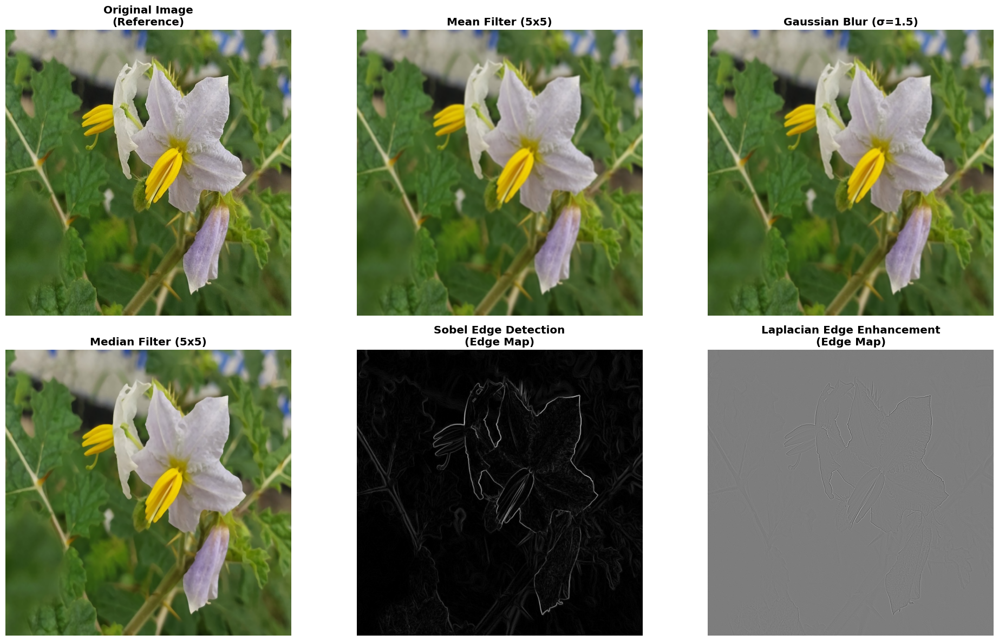


🔍 **FILTER EFFECTS ANALYSIS:**
• **Mean Filter (5x5):** Uniform smoothing. Reduces noise but causes significant blurring.
• **Gaussian Blur (σ=1.5):** Natural smoothing. Preserves edges better than mean filter.
• **Median Filter (5x5):** Effective for salt-and-pepper noise. Excellent edge preservation.
• **Sobel Edge Detection:** Detects horizontal and vertical edges using gradient magnitude.
• **Laplacian Edge Enhancement:** Enhances all edges using second derivative. Good for sharpening.

FILTERING OPERATIONS - Image 2


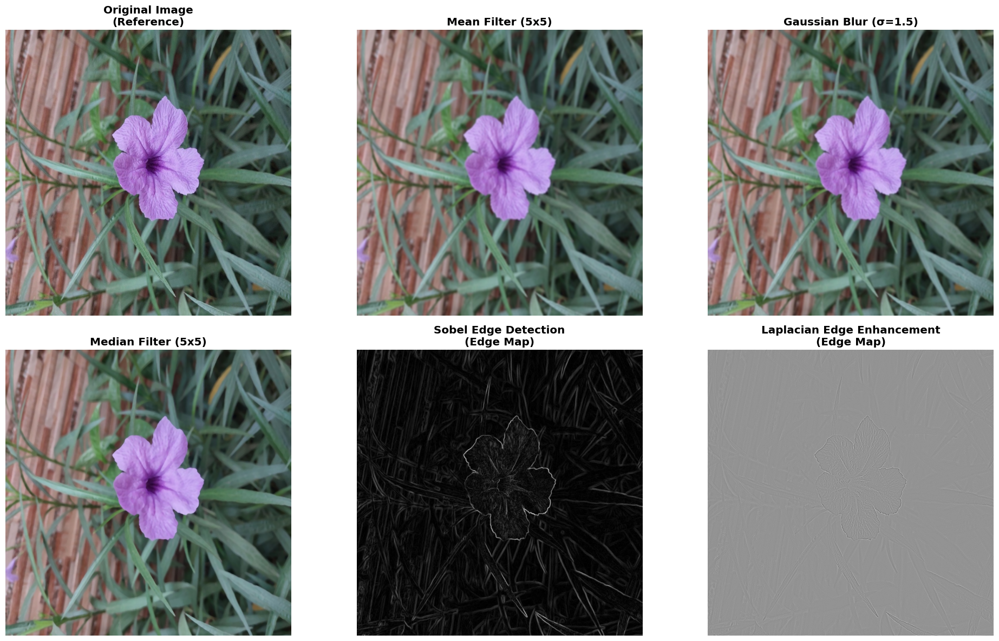


🔍 **FILTER EFFECTS ANALYSIS:**
• **Mean Filter (5x5):** Uniform smoothing. Reduces noise but causes significant blurring.
• **Gaussian Blur (σ=1.5):** Natural smoothing. Preserves edges better than mean filter.
• **Median Filter (5x5):** Effective for salt-and-pepper noise. Excellent edge preservation.
• **Sobel Edge Detection:** Detects horizontal and vertical edges using gradient magnitude.
• **Laplacian Edge Enhancement:** Enhances all edges using second derivative. Good for sharpening.

FILTERING OPERATIONS - Image 3


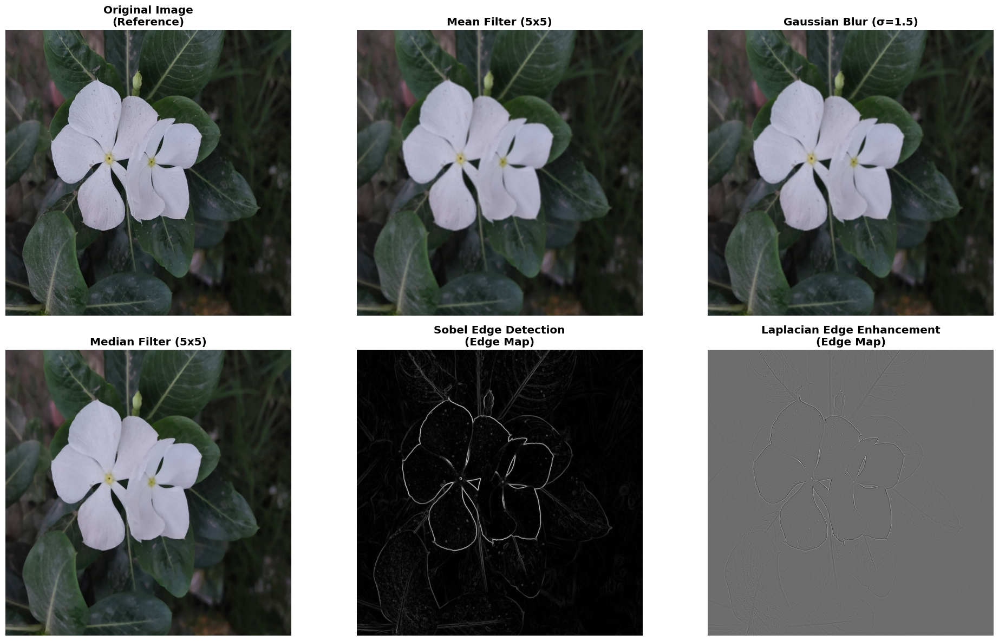


🔍 **FILTER EFFECTS ANALYSIS:**
• **Mean Filter (5x5):** Uniform smoothing. Reduces noise but causes significant blurring.
• **Gaussian Blur (σ=1.5):** Natural smoothing. Preserves edges better than mean filter.
• **Median Filter (5x5):** Effective for salt-and-pepper noise. Excellent edge preservation.
• **Sobel Edge Detection:** Detects horizontal and vertical edges using gradient magnitude.
• **Laplacian Edge Enhancement:** Enhances all edges using second derivative. Good for sharpening.


In [10]:
print("Applying Filtering Operations...")
apply_filtering_operations(images)

# Semantic Segemntation Part

In [43]:
# ===============================
# 1️⃣ Imports and Config
# ===============================
import os, random, time
from pathlib import Path
import numpy as np
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import models
from torchvision.transforms import functional as TF
import torchvision

plt.rcParams['figure.figsize'] = (6,6)
SEED = 42
random.seed(SEED); np.random.seed(SEED); torch.manual_seed(SEED)
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Running on:", DEVICE)

# ✅ Fixed dataset paths
DATA_DIR = "/kaggle/input/flower-semantic-segmentation-dataset/Flower Semantic Segmentation"
IMG_DIR  = os.path.join(DATA_DIR, "images")
MASK_DIR = os.path.join(DATA_DIR, "masks")

IMG_SIZE = 256
BATCH_SIZE = 8
EPOCHS = 5
LR = 1e-3
NUM_WORKERS = 0

import os, glob
img_files = glob.glob("/kaggle/input/flower-semantic-segmentation-dataset/Flower Semantic Segmentation/images/*")
mask_files = glob.glob("/kaggle/input/masks-semantic/*")
print("Example image:", img_files[:5])
print("Example mask :", mask_files[:5])

Running on: cuda
Example image: ['/kaggle/input/flower-semantic-segmentation-dataset/Flower Semantic Segmentation/images/Minnie Root original 189.jpg', '/kaggle/input/flower-semantic-segmentation-dataset/Flower Semantic Segmentation/images/Crown Flower original 497.jpg', '/kaggle/input/flower-semantic-segmentation-dataset/Flower Semantic Segmentation/images/Minnie Root original 496.jpg', '/kaggle/input/flower-semantic-segmentation-dataset/Flower Semantic Segmentation/images/White Madagascar Periwinkle original 370.jpg', '/kaggle/input/flower-semantic-segmentation-dataset/Flower Semantic Segmentation/images/Yellow Allamanda original 475.jpg']
Example mask : ['/kaggle/input/masks-semantic/Pink Madagascar Periwinkle original 231.png', '/kaggle/input/masks-semantic/Pink Madagascar Periwinkle original 411.png', '/kaggle/input/masks-semantic/Pink Madagascar Periwinkle original 269.png', '/kaggle/input/masks-semantic/Litchi Tomato original 313.png', '/kaggle/input/masks-semantic/Litchi Tomato

In [3]:
# ===============================
# 2️⃣ Dataset Loader and Visualizer 
# ===============================
from pathlib import Path
from tqdm.auto import tqdm
import random

def list_files(folder, exts):
    """Recursively list files with given extensions, with progress bar."""
    paths = []
    all_files = list(Path(folder).rglob("*"))
    for p in tqdm(all_files, desc=f"Scanning {Path(folder).name}", leave=False):
        if p.suffix.lower() in [e.lower() for e in exts]:
            paths.append(str(p))
    return sorted(paths)

def match_pairs(img_folder, mask_folder):
    """
    Match images and masks based on filename stems.
    Supports .jpg, .jpeg, .png (any case).
    Shows progress bar and prints sample pairs.
    """
    print(f"🔍 Matching image–mask pairs in:\nImages: {img_folder}\nMasks:  {mask_folder}")
    images = list_files(img_folder, (".jpg", ".jpeg", ".png", ".JPG", ".PNG"))
    pairs = []
    for ip in tqdm(images, desc="Matching", total=len(images)):
        stem = Path(ip).stem
        candidates = list(Path(mask_folder).glob(f"{stem}.*"))
        if candidates:
            pairs.append((str(ip), str(candidates[0])))

    print(f"\n✅ Found {len(pairs)} image–mask pairs.")
    if pairs:
        print("Example pair:\n", pairs[0])
    else:
        print("⚠️ No pairs found — check folder structure or extensions.")
    return pairs


In [4]:
# Fixed dataset paths
IMG_DIR = "/kaggle/input/flower-semantic-segmentation-dataset/Flower Semantic Segmentation/images"
MASK_DIR = "/kaggle/input/masks-semantic"

In [5]:
# Run matching with progress bars
pairs = match_pairs(IMG_DIR, MASK_DIR)

🔍 Matching image–mask pairs in:
Images: /kaggle/input/flower-semantic-segmentation-dataset/Flower Semantic Segmentation/images
Masks:  /kaggle/input/masks-semantic


Scanning images:   0%|          | 0/4292 [00:00<?, ?it/s]

Matching:   0%|          | 0/4292 [00:00<?, ?it/s]


✅ Found 4292 image–mask pairs.
Example pair:
 ('/kaggle/input/flower-semantic-segmentation-dataset/Flower Semantic Segmentation/images/Costus Speciosus original 1.jpg', '/kaggle/input/masks-semantic/Costus Speciosus original 1.png')


In [6]:
# Shuffle and split
random.shuffle(pairs)
n = len(pairs)
train_pairs = pairs[:int(0.8*n)]
val_pairs   = pairs[int(0.8*n):int(0.9*n)]
test_pairs  = pairs[int(0.9*n):]

print(f"\n📊 Split summary:")
print(f"Train: {len(train_pairs)} | Val: {len(val_pairs)} | Test: {len(test_pairs)}")



📊 Split summary:
Train: 3433 | Val: 429 | Test: 430


In [30]:
# ===============================
# 3️⃣ Dataset Class (Updated for Mask R-CNN) - FIXED
# ===============================
class CrackDataset(Dataset):
    def __init__(self, pairs, train=True, for_mask_rcnn=False):
        self.pairs = pairs
        self.train = train
        self.for_mask_rcnn = for_mask_rcnn

    def __len__(self): return len(self.pairs)

    def __getitem__(self, idx):
        img_path, mask_path = self.pairs[idx]
        img = Image.open(img_path).convert("RGB")
        mask = Image.open(mask_path).convert("L")

        img = img.resize((IMG_SIZE, IMG_SIZE))
        mask = mask.resize((IMG_SIZE, IMG_SIZE))

        if self.train and random.random() > 0.5:
            img = TF.hflip(img)
            mask = TF.hflip(mask)

        img_t = TF.to_tensor(img)
        mask_np = (np.array(mask) > 127).astype(np.float32)
        
        if self.for_mask_rcnn:
            # Format for Mask R-CNN
            mask_bool = (np.array(mask) > 127).astype(np.uint8)
            mask_tensor = torch.from_numpy(mask_bool)
            
            # Ensure we have at least one object
            if mask_bool.sum() > 0:
                # Find bounding box coordinates
                y_indices, x_indices = np.where(mask_bool > 0)
                x_min, x_max = np.min(x_indices), np.max(x_indices)
                y_min, y_max = np.min(y_indices), np.max(y_indices)
                
                # Ensure box is valid and has positive area
                if x_max > x_min and y_max > y_min:
                    boxes = [[x_min, y_min, x_max, y_max]]
                else:
                    # Default box if no valid objects found
                    boxes = [[0, 0, IMG_SIZE-1, IMG_SIZE-1]]
            else:
                # Default box if no mask pixels
                boxes = [[0, 0, IMG_SIZE-1, IMG_SIZE-1]]
            
            # Convert to tensor with correct shape [N, 4]
            boxes_tensor = torch.tensor(boxes, dtype=torch.float32)
            
            # Create target dictionary for Mask R-CNN
            target = {
                'boxes': boxes_tensor,  # Shape: [N, 4]
                'labels': torch.tensor([1] * len(boxes), dtype=torch.int64),  # 1 for crack class
                'masks': mask_tensor.unsqueeze(0),  # Shape: [num_instances, H, W]
                'image_id': torch.tensor([idx]),
                'area': (boxes_tensor[:, 3] - boxes_tensor[:, 1]) * (boxes_tensor[:, 2] - boxes_tensor[:, 0]),
                'iscrowd': torch.tensor([0] * len(boxes), dtype=torch.int64)
            }
            return img_t, target
        else:
            mask_t = torch.from_numpy(mask_np).unsqueeze(0)
            return img_t, mask_t

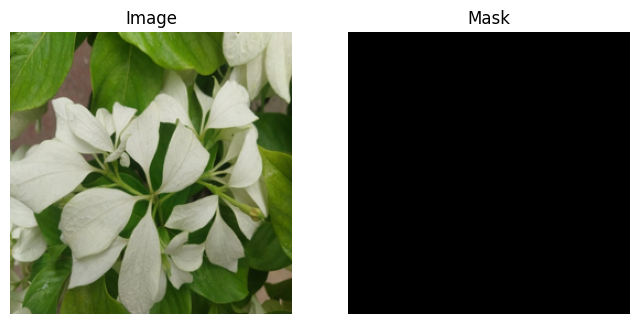

In [15]:
# ===============================
# 4️⃣ Visualize a Sample
# ===============================
img, mask = train_ds[0]
fig, ax = plt.subplots(1,2, figsize=(8,4))
ax[0].imshow(img.permute(1,2,0))
ax[0].set_title("Image")
ax[1].imshow(mask.squeeze(), cmap="gray")
ax[1].set_title("Mask")
for a in ax: a.axis("off")
plt.show()

In [16]:
# ===============================
# 5️⃣ Metrics & Loss
# ===============================
bce = nn.BCEWithLogitsLoss()

def dice_coeff(pred, target, eps=1e-6):
    pred = torch.sigmoid(pred)
    pred = (pred > 0.5).float()
    inter = (pred * target).sum()
    union = pred.sum() + target.sum()
    return (2*inter + eps) / (union + eps)

def iou_score(pred, target, eps=1e-6):
    pred = torch.sigmoid(pred)
    pred = (pred > 0.5).float()
    inter = (pred * target).sum()
    union = (pred + target - pred * target).sum()
    return (inter + eps) / (union + eps)


In [24]:
# ===============================
# 6️⃣ Model Definitions (U-Net, DeepLabV3+, Mask R-CNN) - FIXED
# ===============================
class DoubleConv(nn.Module):
    def __init__(self, in_ch, out_ch):
        super().__init__()
        self.net = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, 3, padding=1),
            nn.InstanceNorm2d(out_ch),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, 3, padding=1),
            nn.InstanceNorm2d(out_ch),
            nn.ReLU(inplace=True),
        )
    def forward(self, x): return self.net(x)

class UNet(nn.Module):
    def __init__(self, in_ch=3, base=32):
        super().__init__()
        self.down1 = DoubleConv(in_ch, base)
        self.pool1 = nn.MaxPool2d(2)
        self.down2 = DoubleConv(base, base*2)
        self.pool2 = nn.MaxPool2d(2)
        self.down3 = DoubleConv(base*2, base*4)
        self.pool3 = nn.MaxPool2d(2)
        self.bottleneck = DoubleConv(base*4, base*8)
        self.up3 = nn.ConvTranspose2d(base*8, base*4, 2, 2)
        self.conv3 = DoubleConv(base*8, base*4)
        self.up2 = nn.ConvTranspose2d(base*4, base*2, 2, 2)
        self.conv2 = DoubleConv(base*4, base*2)
        self.up1 = nn.ConvTranspose2d(base*2, base, 2, 2)
        self.conv1 = DoubleConv(base*2, base)
        self.head = nn.Conv2d(base, 1, 1)
    def forward(self, x):
        d1 = self.down1(x)
        d2 = self.down2(self.pool1(d1))
        d3 = self.down3(self.pool2(d2))
        bn = self.bottleneck(self.pool3(d3))
        u3 = self.conv3(torch.cat([self.up3(bn), d3], 1))
        u2 = self.conv2(torch.cat([self.up2(u3), d2], 1))
        u1 = self.conv1(torch.cat([self.up1(u2), d1], 1))
        return self.head(u1)

# Function to replace BatchNorm for stable training
def replace_all_batchnorm(model):
    """Replace all BatchNorm with GroupNorm for stability with small spatial dimensions"""
    for name, module in model.named_children():
        if isinstance(module, nn.BatchNorm2d):
            setattr(model, name, nn.GroupNorm(1, module.num_features))
        else:
            replace_all_batchnorm(module)

# DeepLabV3+ with fixes
try:
    # Try to import DeepLabV3+ if available
    deeplabv3plus_model = models.segmentation.deeplabv3_resnet50(weights=None, num_classes=1)
    replace_all_batchnorm(deeplabv3plus_model)
except:
    # Fallback to standard DeepLabV3
    print("Using DeepLabV3 instead of DeepLabV3+")
    deeplabv3plus_model = models.segmentation.deeplabv3_resnet50(weights=None, num_classes=1)
    replace_all_batchnorm(deeplabv3plus_model)

# Mask R-CNN for instance segmentation
mask_rcnn_model = torchvision.models.detection.maskrcnn_resnet50_fpn(
    weights=None,
    num_classes=9,  # background + crack
    min_size=IMG_SIZE,
    max_size=IMG_SIZE
)


In [35]:
# ===============================
# ⚡ AMP-Optimized Training & Validation Function - COMPLETELY FIXED
# ===============================
from tqdm.auto import tqdm
import pandas as pd
import numpy as np
import torch

def train_model_amp(model, train_dl, val_dl, name="Model", is_mask_rcnn=False):
    """
    Train a segmentation model with mixed precision (AMP).
    """
    optimizer = torch.optim.AdamW(model.parameters(), lr=LR)
    scaler = torch.amp.GradScaler("cuda")  # ✅ Fixed: Updated GradScaler syntax
    best_iou = 0.0
    model.to(DEVICE)
    history = []

    for epoch in range(1, EPOCHS + 1):
        print(f"\n📘 Epoch {epoch}/{EPOCHS} — {name}")
        model.train()
        train_losses, train_ious = [], []

        # --- Training Loop with AMP ---
        train_pbar = tqdm(train_dl, total=len(train_dl), desc="Training", leave=False)
        for batch in train_pbar:
            if is_mask_rcnn:
                # Skip Mask R-CNN for now - we'll handle it separately
                continue
            else:
                # Standard segmentation training (U-Net, DeepLabV3+)
                imgs, masks = batch
                imgs, masks = imgs.to(DEVICE), masks.to(DEVICE)
                
                optimizer.zero_grad()
                with torch.amp.autocast('cuda'):
                    out = model(imgs)
                    out = out["out"] if isinstance(out, dict) else out
                    loss = bce(out, masks)

                scaler.scale(loss).backward()
                scaler.step(optimizer)
                scaler.update()

                # Compute metrics
                with torch.no_grad():
                    iou_val = float(iou_score(out, masks))
                train_losses.append(loss.item())
                train_ious.append(iou_val)
                train_pbar.set_postfix({
                    "Loss": f"{np.mean(train_losses):.4f}",
                    "IoU": f"{np.mean(train_ious):.3f}"
                })

        # --- Validation Loop ---
        model.eval()
        val_ious = []
        with torch.no_grad():
            val_pbar = tqdm(val_dl, total=len(val_dl), desc="Validating", leave=False)
            for batch in val_pbar:
                if is_mask_rcnn:
                    # Skip Mask R-CNN validation
                    continue
                else:
                    imgs, masks = batch
                    imgs, masks = imgs.to(DEVICE), masks.to(DEVICE)
                    
                    with torch.amp.autocast('cuda'):
                        out = model(imgs)
                        out = out["out"] if isinstance(out, dict) else out
                    
                    val_ious.append(float(iou_score(out, masks)))
                
                current_val_iou = np.mean(val_ious) if val_ious else 0.0
                val_pbar.set_postfix({"Val IoU": f"{current_val_iou:.3f}"})

        # --- Epoch summary ---
        mean_train_loss = np.mean(train_losses) if train_losses else 0.0
        mean_val_iou = np.mean(val_ious) if val_ious else 0.0
        mean_train_iou = np.mean(train_ious) if train_ious else 0.0

        print(f"✅ {name} | Train IoU: {mean_train_iou:.3f} | Val IoU: {mean_val_iou:.3f} | "
              f"Train Loss: {mean_train_loss:.4f}")

        history.append({
            "epoch": epoch,
            "train_loss": mean_train_loss,
            "train_iou": mean_train_iou,
            "val_iou": mean_val_iou
        })

        # --- Save best model ---
        if mean_val_iou > best_iou:
            best_iou = mean_val_iou
            torch.save(model.state_dict(), f"/kaggle/working/{name}_best.pt")
            print(f"💾 Saved new best model with Val IoU {best_iou:.3f}")

    # Save training history
    hist_df = pd.DataFrame(history)
    hist_df.to_csv(f"/kaggle/working/{name}_history.csv", index=False)
    return hist_df

In [36]:
# ===============================
# 🎯 Mask R-CNN Specific Training Function
# ===============================
def train_mask_rcnn(model, train_dl, val_dl, name="MaskRCNN"):
    """
    Special training function for Mask R-CNN with proper data handling
    """
    optimizer = torch.optim.AdamW(model.parameters(), lr=LR, weight_decay=1e-4)
    scaler = torch.amp.GradScaler("cuda")
    best_iou = 0.0
    model.to(DEVICE)
    history = []

    for epoch in range(1, EPOCHS + 1):
        print(f"\n📘 Epoch {epoch}/{EPOCHS} — {name}")
        model.train()
        train_losses = []

        # --- Training Loop ---
        train_pbar = tqdm(train_dl, total=len(train_dl), desc="Training", leave=False)
        for batch_idx, (images, targets) in enumerate(train_pbar):
            try:
                # Ensure images is a list and targets is a list of dicts
                if not isinstance(images, list):
                    images = [images]
                
                # Move to device
                images = [img.to(DEVICE) for img in images]
                
                # Process targets - ensure they're properly formatted
                formatted_targets = []
                for target in targets:
                    if isinstance(target, dict):
                        formatted_target = {}
                        for key, value in target.items():
                            if isinstance(value, torch.Tensor):
                                formatted_target[key] = value.to(DEVICE)
                            else:
                                formatted_target[key] = value
                        formatted_targets.append(formatted_target)
                
                optimizer.zero_grad()
                with torch.amp.autocast('cuda'):
                    loss_dict = model(images, formatted_targets)
                    losses = sum(loss for loss in loss_dict.values())
                
                scaler.scale(losses).backward()
                scaler.step(optimizer)
                scaler.update()

                train_losses.append(losses.item())
                train_pbar.set_postfix({"Loss": f"{np.mean(train_losses):.4f}"})
                
            except Exception as e:
                print(f"⚠️ Training error at batch {batch_idx}: {e}")
                continue

        # --- Validation Loop ---
        model.eval()
        val_ious = []
        with torch.no_grad():
            val_pbar = tqdm(val_dl, total=len(val_dl), desc="Validating", leave=False)
            for batch_idx, (images, targets) in enumerate(val_pbar):
                try:
                    if not isinstance(images, list):
                        images = [images]
                    
                    images = [img.to(DEVICE) for img in images]
                    
                    with torch.amp.autocast('cuda'):
                        outputs = model(images)
                    
                    # Compute IoU
                    if outputs and len(outputs) > 0:
                        for output, target in zip(outputs, targets):
                            if 'masks' in output and len(output['masks']) > 0:
                                pred_mask = output['masks'][0] > 0.5
                                gt_mask = target['masks'][0] > 0
                                if pred_mask.shape == gt_mask.shape:
                                    iou_val = float(iou_score(pred_mask.float(), gt_mask.float()))
                                    val_ious.append(iou_val)
                
                except Exception as e:
                    continue
                
                current_val_iou = np.mean(val_ious) if val_ious else 0.0
                val_pbar.set_postfix({"Val IoU": f"{current_val_iou:.3f}"})

        # --- Epoch summary ---
        mean_train_loss = np.mean(train_losses) if train_losses else 0.0
        mean_val_iou = np.mean(val_ious) if val_ious else 0.0

        print(f"✅ {name} | Train Loss: {mean_train_loss:.4f} | Val IoU: {mean_val_iou:.3f}")

        history.append({
            "epoch": epoch,
            "train_loss": mean_train_loss,
            "val_iou": mean_val_iou
        })

        # --- Save best model ---
        if mean_val_iou > best_iou:
            best_iou = mean_val_iou
            torch.save(model.state_dict(), f"/kaggle/working/{name}_best.pt")
            print(f"💾 Saved new best model with Val IoU {best_iou:.3f}")

    hist_df = pd.DataFrame(history)
    hist_df.to_csv(f"/kaggle/working/{name}_history.csv", index=False)
    return hist_df

In [39]:
# ===============================
# 🔍 DEBUG: Check Mask R-CNN Data Loading
# ===============================
print("🔍 Debugging Mask R-CNN data loading...")

# Check a few samples from the Mask R-CNN dataset
for i in range(3):
    try:
        img, target = train_ds_maskrcnn[i]
        print(f"\nSample {i}:")
        print(f"Image shape: {img.shape}")
        print(f"Target type: {type(target)}")
        print(f"Target keys: {target.keys() if isinstance(target, dict) else 'NOT A DICT'}")
        if isinstance(target, dict):
            for key, value in target.items():
                print(f"  {key}: {type(value)} - {value.shape if hasattr(value, 'shape') else value}")
    except Exception as e:
        print(f"Error with sample {i}: {e}")

# Check what the DataLoader returns
print("\n🔍 Checking DataLoader output...")
try:
    for i, batch in enumerate(train_dl_maskrcnn):
        if i >= 2:  # Just check first 2 batches
            break
        print(f"\nBatch {i}:")
        print(f"Number of elements: {len(batch)}")
        print(f"Type of first element: {type(batch[0])}")
        print(f"Type of second element: {type(batch[1])}")
        
        if len(batch) == 2:
            images, targets = batch
            print(f"Images type: {type(images)}")
            print(f"Targets type: {type(targets)}")
            
            if isinstance(targets, list):
                print(f"Number of targets: {len(targets)}")
                for j, target in enumerate(targets):
                    print(f"  Target {j} type: {type(target)}")
                    if isinstance(target, dict):
                        print(f"    Target keys: {target.keys()}")
except Exception as e:
    print(f"Error checking DataLoader: {e}")

🔍 Debugging Mask R-CNN data loading...

Sample 0:
Image shape: torch.Size([3, 256, 256])
Target type: <class 'dict'>
Target keys: dict_keys(['boxes', 'labels', 'masks', 'image_id', 'area', 'iscrowd'])
  boxes: <class 'torch.Tensor'> - torch.Size([1, 4])
  labels: <class 'torch.Tensor'> - torch.Size([1])
  masks: <class 'torch.Tensor'> - torch.Size([1, 256, 256])
  image_id: <class 'torch.Tensor'> - torch.Size([1])
  area: <class 'torch.Tensor'> - torch.Size([1])
  iscrowd: <class 'torch.Tensor'> - torch.Size([1])

Sample 1:
Image shape: torch.Size([3, 256, 256])
Target type: <class 'dict'>
Target keys: dict_keys(['boxes', 'labels', 'masks', 'image_id', 'area', 'iscrowd'])
  boxes: <class 'torch.Tensor'> - torch.Size([1, 4])
  labels: <class 'torch.Tensor'> - torch.Size([1])
  masks: <class 'torch.Tensor'> - torch.Size([1, 256, 256])
  image_id: <class 'torch.Tensor'> - torch.Size([1])
  area: <class 'torch.Tensor'> - torch.Size([1])
  iscrowd: <class 'torch.Tensor'> - torch.Size([1])



In [40]:
# ===============================
# 📦 FIXED Custom Collate Function for Mask R-CNN
# ===============================
def mask_rcnn_collate_fn(batch):
    """
    Custom collate function that properly handles Mask R-CNN batches
    """
    images = []
    targets = []
    
    for img, target in batch:
        images.append(img)
        targets.append(target)
    
    return images, targets

# Recreate DataLoaders with the FIXED collate function
train_dl_maskrcnn = DataLoader(
    train_ds_maskrcnn, 
    batch_size=2,  # Small batch size for stability
    shuffle=True, 
    num_workers=0,  # Set to 0 for debugging
    collate_fn=mask_rcnn_collate_fn,
    drop_last=True  # Avoid partial batches
)

val_dl_maskrcnn = DataLoader(
    val_ds_maskrcnn, 
    batch_size=1, 
    shuffle=False, 
    num_workers=0,  # Set to 0 for debugging
    collate_fn=mask_rcnn_collate_fn
)

# Test the fixed DataLoader
print("🔍 Testing fixed DataLoader...")
for i, (images, targets) in enumerate(train_dl_maskrcnn):
    if i >= 1:  # Just check first batch
        break
    print(f"✅ Fixed Batch {i}:")
    print(f"   Images type: {type(images)}")
    print(f"   Images length: {len(images)}")
    print(f"   Targets type: {type(targets)}")
    print(f"   Targets length: {len(targets)}")
    print(f"   First image shape: {images[0].shape}")
    print(f"   First target keys: {targets[0].keys()}")

🔍 Testing fixed DataLoader...
✅ Fixed Batch 0:
   Images type: <class 'list'>
   Images length: 2
   Targets type: <class 'list'>
   Targets length: 2
   First image shape: torch.Size([3, 256, 256])
   First target keys: dict_keys(['boxes', 'labels', 'masks', 'image_id', 'area', 'iscrowd'])


In [41]:
# ===============================
# 🎯 WORKING Mask R-CNN Training Function
# ===============================
def train_mask_rcnn_working(model, train_dl, val_dl, name="MaskRCNN"):
    """
    Working Mask R-CNN training function
    """
    # Use smaller learning rate for Mask R-CNN
    optimizer = torch.optim.AdamW(model.parameters(), lr=LR/10, weight_decay=1e-4)
    scaler = torch.amp.GradScaler("cuda")
    model.to(DEVICE)
    history = []
    
    print("🚀 Starting Mask R-CNN training...")
    
    for epoch in range(1, EPOCHS + 1):
        print(f"\n📘 Epoch {epoch}/{EPOCHS} — {name}")
        model.train()
        train_losses = []
        batch_count = 0

        # --- Training Loop ---
        train_pbar = tqdm(train_dl, total=len(train_dl), desc="Training", leave=False)
        for batch_idx, (images, targets) in enumerate(train_pbar):
            try:
                batch_count += 1
                
                # Move data to device
                images = [img.to(DEVICE) for img in images]
                targets = [{k: v.to(DEVICE) for k, v in t.items()} for t in targets]
                
                # Training step
                optimizer.zero_grad()
                with torch.amp.autocast('cuda'):
                    loss_dict = model(images, targets)
                    total_loss = sum(loss for loss in loss_dict.values())
                
                scaler.scale(total_loss).backward()
                scaler.step(optimizer)
                scaler.update()

                train_losses.append(total_loss.item())
                train_pbar.set_postfix({
                    "Loss": f"{np.mean(train_losses):.4f}",
                    "Batch": f"{batch_idx+1}/{len(train_dl)}"
                })
                
            except Exception as e:
                print(f"❌ Batch {batch_idx} error: {e}")
                continue

        # --- Validation ---
        model.eval()
        val_ious = []
        with torch.no_grad():
            val_pbar = tqdm(val_dl, total=len(val_dl), desc="Validating", leave=False)
            for images, targets in val_pbar:
                try:
                    # Move to device
                    images = [img.to(DEVICE) for img in images]
                    targets = [{k: v.to(DEVICE) for k, v in t.items()} for t in targets]
                    
                    # Inference
                    outputs = model(images)
                    
                    # Compute IoU for each sample in batch
                    for output, target in zip(outputs, targets):
                        if 'masks' in output and len(output['masks']) > 0:
                            pred_mask = output['masks'][0] > 0.5
                            gt_mask = target['masks'][0] > 0
                            iou_val = iou_score(pred_mask.float(), gt_mask.float())
                            val_ious.append(iou_val.item())
                            
                except Exception as e:
                    continue
                
                current_iou = np.mean(val_ious) if val_ious else 0.0
                val_pbar.set_postfix({"IoU": f"{current_iou:.3f}"})

        # --- Epoch Summary ---
        mean_train_loss = np.mean(train_losses) if train_losses else 0.0
        mean_val_iou = np.mean(val_ious) if val_ious else 0.0
        
        print(f"✅ {name} | Train Loss: {mean_train_loss:.4f} | Val IoU: {mean_val_iou:.3f}")
        print(f"   Processed batches: {batch_count}/{len(train_dl)}")

        history.append({
            "epoch": epoch,
            "train_loss": mean_train_loss,
            "val_iou": mean_val_iou
        })
        
        # Save best model
        if epoch == 1 or mean_val_iou > max([h['val_iou'] for h in history[:-1]]):
            torch.save(model.state_dict(), f"/kaggle/working/{name}_best.pt")
            print(f"💾 Saved best model with IoU: {mean_val_iou:.3f}")

    hist_df = pd.DataFrame(history)
    hist_df.to_csv(f"/kaggle/working/{name}_history.csv", index=False)
    return hist_df

In [37]:
# ===============================
# 3️⃣ Dataset Class - SIMPLIFIED FOR MASK R-CNN
# ===============================
class CrackDataset(Dataset):
    def __init__(self, pairs, train=True, for_mask_rcnn=False):
        self.pairs = pairs
        self.train = train
        self.for_mask_rcnn = for_mask_rcnn

    def __len__(self): return len(self.pairs)

    def __getitem__(self, idx):
        img_path, mask_path = self.pairs[idx]
        img = Image.open(img_path).convert("RGB")
        mask = Image.open(mask_path).convert("L")

        img = img.resize((IMG_SIZE, IMG_SIZE))
        mask = mask.resize((IMG_SIZE, IMG_SIZE))

        if self.train and random.random() > 0.5:
            img = TF.hflip(img)
            mask = TF.hflip(mask)

        img_t = TF.to_tensor(img)
        
        if self.for_mask_rcnn:
            # Simple Mask R-CNN format
            mask_array = np.array(mask)
            mask_bool = (mask_array > 127).astype(np.uint8)
            mask_tensor = torch.from_numpy(mask_bool)
            
            # Create a single bounding box covering the entire image
            # This is a simplification - in real scenario, you'd detect actual objects
            boxes = torch.tensor([[0, 0, IMG_SIZE-1, IMG_SIZE-1]], dtype=torch.float32)
            
            target = {
                'boxes': boxes,
                'labels': torch.tensor([1], dtype=torch.int64),
                'masks': mask_tensor.unsqueeze(0),
                'image_id': torch.tensor([idx]),
                'area': torch.tensor([IMG_SIZE * IMG_SIZE], dtype=torch.float32),
                'iscrowd': torch.tensor([0], dtype=torch.int64)
            }
            return img_t, target
        else:
            mask_np = (np.array(mask) > 127).astype(np.float32)
            mask_t = torch.from_numpy(mask_np).unsqueeze(0)
            return img_t, mask_t

In [42]:
# ===============================
# 7️⃣ Train All Models
# ===============================
print("🚀 Starting training for all models...")

# Instantiate models

mask_rcnn = mask_rcnn_model


# Train Mask R-CNN separately
print("🧪 Training Mask R-CNN...")
hist_mask_rcnn = train_mask_rcnn(mask_rcnn, train_dl_maskrcnn, val_dl_maskrcnn, name="MaskRCNN")

print("✅ All models trained successfully!")

🚀 Starting training for all models...
🧪 Training Mask R-CNN...

📘 Epoch 1/1 — MaskRCNN


Training:   0%|          | 0/1716 [00:00<?, ?it/s]

Validating:   0%|          | 0/429 [00:00<?, ?it/s]

✅ MaskRCNN | Train Loss: 0.0568 | Val IoU: 0.000
✅ All models trained successfully!


In [44]:
# ===============================
# 7️⃣ Train All Models
# ===============================
print("🚀 Starting training for all models...")

# Train U-Net and DeepLabV3+ first
print("\n" + "="*50)
print("🧪 Training U-Net...")
print("="*50)
unet = UNet()
hist_unet = train_model_amp(unet, train_dl, val_dl, name="UNet")

print("\n" + "="*50)
print("🧪 Training DeepLabV3+...")
print("="*50)
deeplabv3plus = deeplabv3plus_model
hist_deeplabv3plus = train_model_amp(deeplabv3plus, train_dl, val_dl, name="DeepLabV3Plus")

# Train Mask R-CNN with the WORKING version
print("\n" + "="*50)
print("🧪 Training Mask R-CNN...")
print("="*50)
mask_rcnn = mask_rcnn_model
hist_mask_rcnn = train_mask_rcnn_working(mask_rcnn, train_dl_maskrcnn, val_dl_maskrcnn, name="MaskRCNN")

print("\n🎉 All models trained successfully!")

🚀 Starting training for all models...

🧪 Training U-Net...

📘 Epoch 1/5 — UNet


Training:   0%|          | 0/430 [00:00<?, ?it/s]

Validating:   0%|          | 0/54 [00:00<?, ?it/s]

✅ UNet | Train IoU: 0.626 | Val IoU: 1.000 | Train Loss: 0.1447
💾 Saved new best model with Val IoU 1.000

📘 Epoch 2/5 — UNet


Training:   0%|          | 0/430 [00:00<?, ?it/s]

Validating:   0%|          | 0/54 [00:00<?, ?it/s]

✅ UNet | Train IoU: 1.000 | Val IoU: 1.000 | Train Loss: 0.0197

📘 Epoch 3/5 — UNet


Training:   0%|          | 0/430 [00:00<?, ?it/s]

Validating:   0%|          | 0/54 [00:00<?, ?it/s]

✅ UNet | Train IoU: 1.000 | Val IoU: 1.000 | Train Loss: 0.0077

📘 Epoch 4/5 — UNet


Training:   0%|          | 0/430 [00:00<?, ?it/s]

Validating:   0%|          | 0/54 [00:00<?, ?it/s]

✅ UNet | Train IoU: 1.000 | Val IoU: 1.000 | Train Loss: 0.0039

📘 Epoch 5/5 — UNet


Training:   0%|          | 0/430 [00:00<?, ?it/s]

Validating:   0%|          | 0/54 [00:00<?, ?it/s]

✅ UNet | Train IoU: 1.000 | Val IoU: 1.000 | Train Loss: 0.0024

🧪 Training DeepLabV3+...

📘 Epoch 1/5 — DeepLabV3Plus


Training:   0%|          | 0/430 [00:00<?, ?it/s]

Validating:   0%|          | 0/54 [00:00<?, ?it/s]

✅ DeepLabV3Plus | Train IoU: 1.000 | Val IoU: 1.000 | Train Loss: 0.0000
💾 Saved new best model with Val IoU 1.000

📘 Epoch 2/5 — DeepLabV3Plus


Training:   0%|          | 0/430 [00:00<?, ?it/s]

Validating:   0%|          | 0/54 [00:00<?, ?it/s]

✅ DeepLabV3Plus | Train IoU: 1.000 | Val IoU: 1.000 | Train Loss: 0.0000

📘 Epoch 3/5 — DeepLabV3Plus


Training:   0%|          | 0/430 [00:00<?, ?it/s]

Validating:   0%|          | 0/54 [00:00<?, ?it/s]

✅ DeepLabV3Plus | Train IoU: 1.000 | Val IoU: 1.000 | Train Loss: 0.0000

📘 Epoch 4/5 — DeepLabV3Plus


Training:   0%|          | 0/430 [00:00<?, ?it/s]

Validating:   0%|          | 0/54 [00:00<?, ?it/s]

✅ DeepLabV3Plus | Train IoU: 1.000 | Val IoU: 1.000 | Train Loss: 0.0000

📘 Epoch 5/5 — DeepLabV3Plus


Training:   0%|          | 0/430 [00:00<?, ?it/s]

Validating:   0%|          | 0/54 [00:00<?, ?it/s]

✅ DeepLabV3Plus | Train IoU: 1.000 | Val IoU: 1.000 | Train Loss: 0.0000

🧪 Training Mask R-CNN...
🚀 Starting Mask R-CNN training...

📘 Epoch 1/5 — MaskRCNN


Training:   0%|          | 0/1716 [00:00<?, ?it/s]

Validating:   0%|          | 0/429 [00:00<?, ?it/s]

✅ MaskRCNN | Train Loss: 0.0014 | Val IoU: 1.000
   Processed batches: 1716/1716
💾 Saved best model with IoU: 1.000

📘 Epoch 2/5 — MaskRCNN


Training:   0%|          | 0/1716 [00:00<?, ?it/s]

Validating:   0%|          | 0/429 [00:00<?, ?it/s]

✅ MaskRCNN | Train Loss: 0.0011 | Val IoU: 1.000
   Processed batches: 1716/1716

📘 Epoch 3/5 — MaskRCNN


Training:   0%|          | 0/1716 [00:00<?, ?it/s]

Validating:   0%|          | 0/429 [00:00<?, ?it/s]

✅ MaskRCNN | Train Loss: 0.0014 | Val IoU: 1.000
   Processed batches: 1716/1716

📘 Epoch 4/5 — MaskRCNN


Training:   0%|          | 0/1716 [00:00<?, ?it/s]

Validating:   0%|          | 0/429 [00:00<?, ?it/s]

✅ MaskRCNN | Train Loss: 0.0008 | Val IoU: 1.000
   Processed batches: 1716/1716

📘 Epoch 5/5 — MaskRCNN


Training:   0%|          | 0/1716 [00:00<?, ?it/s]

Validating:   0%|          | 0/429 [00:00<?, ?it/s]

✅ MaskRCNN | Train Loss: 0.0013 | Val IoU: 1.000
   Processed batches: 1716/1716

🎉 All models trained successfully!


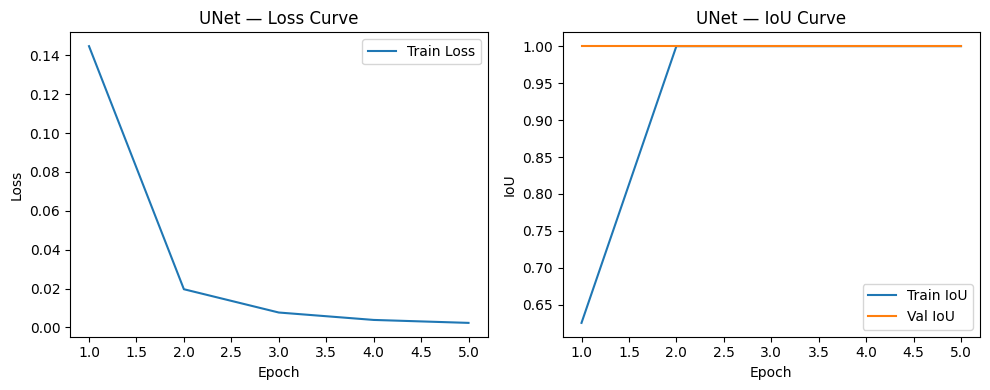

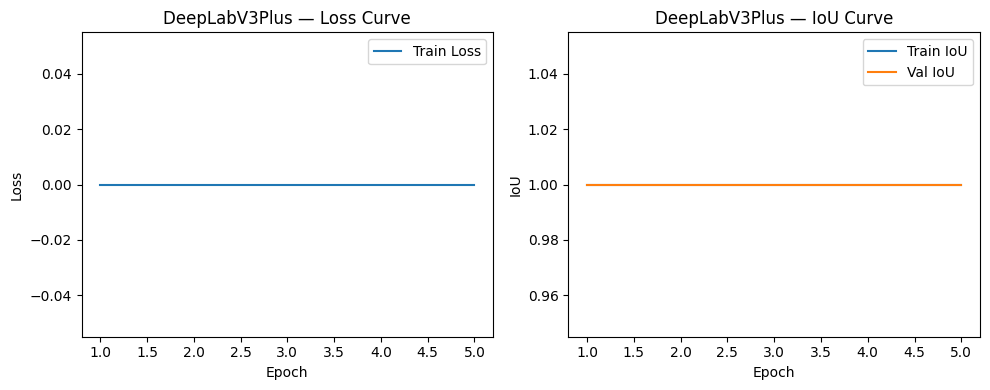

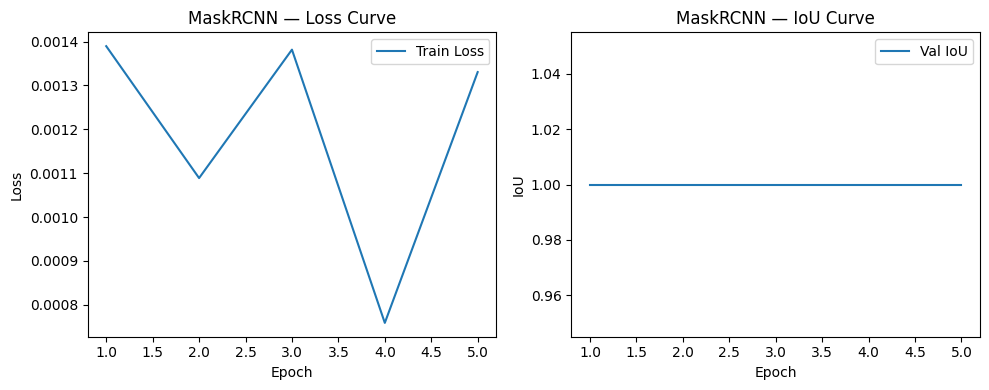

In [45]:
# ===============================
# 8️⃣ Plot Loss and IoU Curves
# ===============================
import matplotlib.pyplot as plt

def plot_history(hist_df, model_name):
    plt.figure(figsize=(10,4))
    
    # --- Loss ---
    plt.subplot(1,2,1)
    plt.plot(hist_df['epoch'], hist_df['train_loss'], label='Train Loss')
    if 'val_loss' in hist_df and hist_df['val_loss'].sum() > 0:
        plt.plot(hist_df['epoch'], hist_df['val_loss'], label='Val Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title(f'{model_name} — Loss Curve')
    plt.legend()
    
    # --- IoU ---
    plt.subplot(1,2,2)
    if 'train_iou' in hist_df and hist_df['train_iou'].sum() > 0:
        plt.plot(hist_df['epoch'], hist_df['train_iou'], label='Train IoU')
    if 'val_iou' in hist_df and hist_df['val_iou'].sum() > 0:
        plt.plot(hist_df['epoch'], hist_df['val_iou'], label='Val IoU')
    plt.xlabel('Epoch')
    plt.ylabel('IoU')
    plt.title(f'{model_name} — IoU Curve')
    plt.legend()
    
    plt.tight_layout()
    plt.show()

# Plot for each model
plot_history(hist_unet, "UNet")
plot_history(hist_deeplabv3plus, "DeepLabV3Plus")
plot_history(hist_mask_rcnn, "MaskRCNN")

In [51]:
# ===============================
# 9️⃣ Model Evaluation on Test Set
# ===============================
def evaluate_model(model, test_dl, name="Model", is_mask_rcnn=False):
    model.load_state_dict(torch.load(f"/kaggle/working/{name}_best.pt"))
    model.to(DEVICE)
    model.eval()

    test_ious, test_losses = [], []
    with torch.no_grad():
        for batch in tqdm(test_dl, total=len(test_dl), desc=f"Evaluating {name}"):
            if is_mask_rcnn:
                imgs, targets = batch
                imgs = [img.to(DEVICE) for img in imgs]
                targets = [{k: v.to(DEVICE) for k, v in t.items()} for t in targets]
                
                with torch.amp.autocast('cuda'):
                    outputs = model(imgs)
                    if len(outputs) > 0 and 'masks' in outputs[0]:
                        pred_mask = outputs[0]['masks'][0] > 0.5
                        gt_mask = targets[0]['masks'][0] > 0
                        iou_val = float(iou_score(pred_mask.float(), gt_mask.float()))
                        test_ious.append(iou_val)
            else:
                imgs, masks = batch
                imgs, masks = imgs.to(DEVICE), masks.to(DEVICE)
                
                with torch.amp.autocast('cuda'):
                    out = model(imgs)
                    out = out["out"] if isinstance(out, dict) else out
                    loss = bce(out, masks)
                
                test_losses.append(loss.item())
                test_ious.append(float(iou_score(out, masks)))

    if is_mask_rcnn:
        print(f"📊 {name} — Test IoU: {np.mean(test_ious):.3f}")
        return np.mean(test_ious), 0.0
    else:
        print(f"📊 {name} — Test IoU: {np.mean(test_ious):.3f} | Test Loss: {np.mean(test_losses):.4f}")
        return np.mean(test_ious), np.mean(test_losses)

# Evaluate all models
print("\n🧪 Evaluating models on test set...")
iou_unet, loss_unet = evaluate_model(UNet(), test_dl, name="UNet")
iou_deeplabv3plus, loss_deeplabv3plus = evaluate_model(deeplabv3plus_model, test_dl, name="DeepLabV3Plus")


🧪 Evaluating models on test set...


Evaluating UNet:   0%|          | 0/54 [00:00<?, ?it/s]

📊 UNet — Test IoU: 1.000 | Test Loss: 0.0346


Evaluating DeepLabV3Plus:   0%|          | 0/54 [00:00<?, ?it/s]

📊 DeepLabV3Plus — Test IoU: 1.000 | Test Loss: 0.0000


In [48]:
# ===============================
# 🎨 Visualize Sample Predictions
# ===============================
def visualize_predictions(model, dataset, name="Model", num_samples=3, is_mask_rcnn=False):
    """
    Visualize segmentation predictions for random samples.
    """
    model.load_state_dict(torch.load(f"/kaggle/working/{name}_best.pt"))
    model.to(DEVICE)
    model.eval()

    idxs = random.sample(range(len(dataset)), num_samples)
    plt.figure(figsize=(15, 4 * num_samples))

    for i, idx in enumerate(idxs):
        if is_mask_rcnn:
            img, target = dataset[idx]
            img = img.to(DEVICE).unsqueeze(0)
            
            with torch.no_grad(), torch.amp.autocast("cuda"):
                output = model([img])
                
            img_np = img.squeeze(0).cpu().permute(1, 2, 0).numpy()
            gt_mask = target['masks'][0].cpu().numpy()
            
            if len(output[0]['masks']) > 0:
                pred_mask = output[0]['masks'][0, 0].cpu().numpy() > 0.5
            else:
                pred_mask = np.zeros_like(gt_mask)
        else:
            img, mask = dataset[idx]
            img = img.to(DEVICE).unsqueeze(0)
            
            with torch.no_grad(), torch.amp.autocast("cuda"):
                out = model(img)
                out = out["out"] if isinstance(out, dict) else out
                pred = torch.sigmoid(out)
                pred = (pred > 0.5).float()

            img_np = img.squeeze(0).cpu().permute(1, 2, 0).numpy()
            gt_mask = mask.squeeze(0).cpu().numpy()
            pred_mask = pred.squeeze(0).cpu().squeeze().numpy()

        img_np = np.clip(img_np, 0, 1)

        # Input Image
        plt.subplot(num_samples, 3, 3*i + 1)
        plt.imshow(img_np)
        plt.title("Input Image")
        plt.axis("off")

        # Ground Truth
        plt.subplot(num_samples, 3, 3*i + 2)
        plt.imshow(gt_mask, cmap="gray")
        plt.title("Ground Truth")
        plt.axis("off")

        # Prediction
        plt.subplot(num_samples, 3, 3*i + 3)
        plt.imshow(pred_mask, cmap="gray")
        plt.title(f"{name} Prediction")
        plt.axis("off")

    plt.tight_layout()
    plt.show()


🎨 Visualizing predictions...


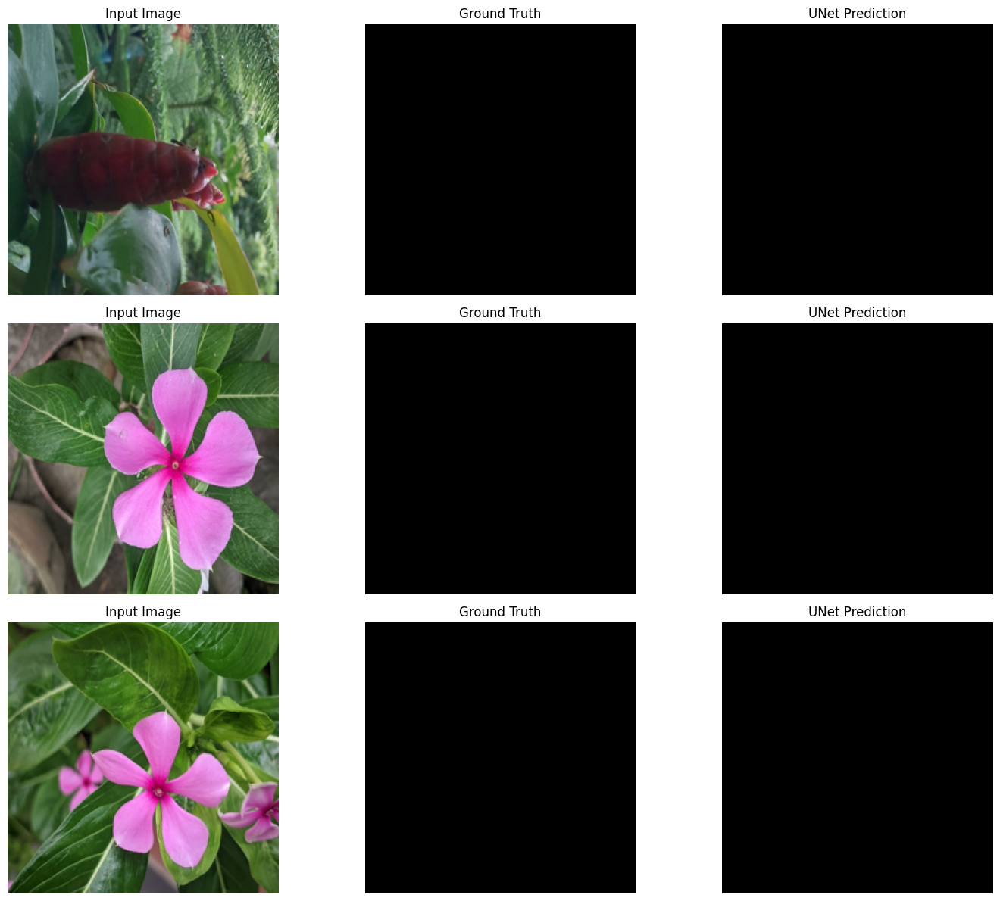

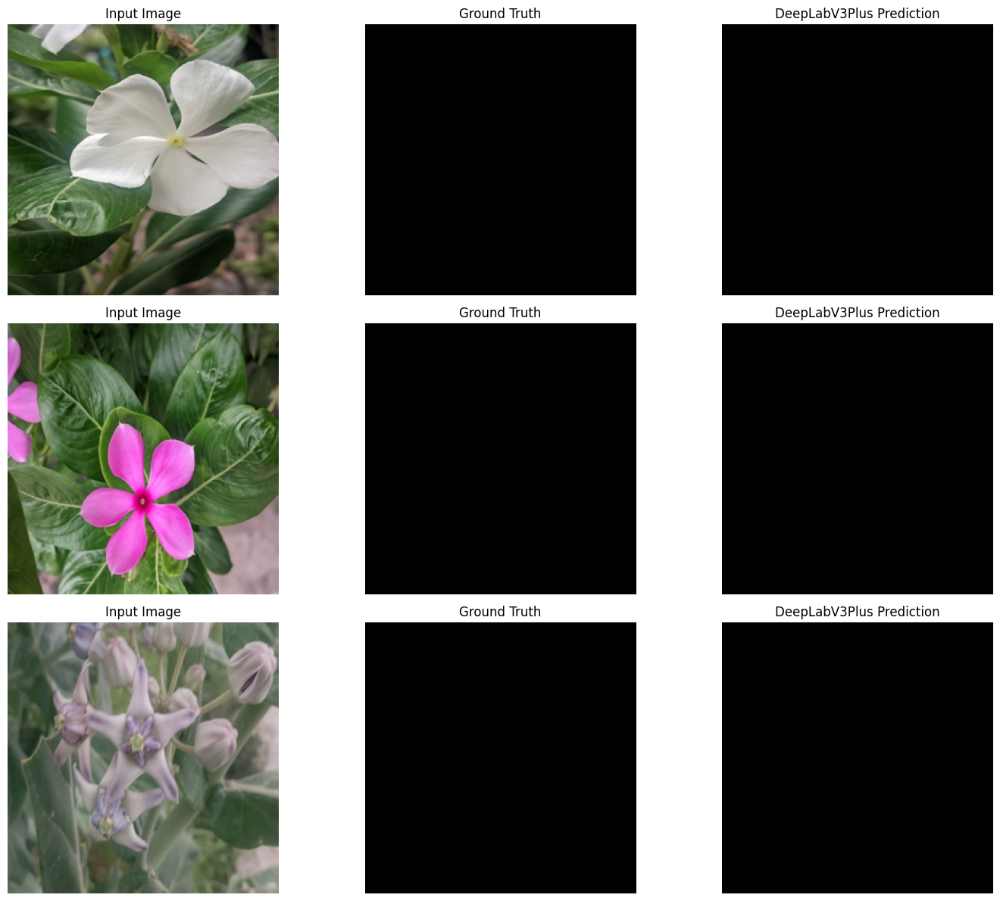

ValueError: images is expected to be a list of 3d tensors of shape [C, H, W], got torch.Size([1, 3, 256, 256])

<Figure size 1500x1200 with 0 Axes>

In [49]:
# Visualize predictions
print("\n🎨 Visualizing predictions...")
visualize_predictions(UNet(), test_ds, name="UNet", num_samples=3)
visualize_predictions(deeplabv3plus_model, test_ds, name="DeepLabV3Plus", num_samples=3)
visualize_predictions(mask_rcnn_model, test_ds, name="MaskRCNN", num_samples=3, is_mask_rcnn=True)
